In [ ]:
# %load_ext autoreload
# %autoreload 2

In [21]:
import time
from hydra_zen import instantiate, make_config, builds, to_yaml
from pathlib import Path
import os
import sys

import chex
from chex import assert_shape, assert_rank
from typing import Callable, Tuple

import jax.numpy as np
from jax import random, vmap
import jax.numpy.linalg as lin

from grassgp.grassmann import grass_log, grass_exp, valid_grass_point, valid_grass_tangent, compute_barycenter, grass_dist, convert_to_projs
from grassgp.utils import vec, unvec, kron_solve, get_save_path, to_dictconf, subspace_angle
from grassgp.utils import safe_save_jax_array_dict as safe_save
from grassgp.kernels import rbf
from grassgp.models import GrassGP
from grassgp.means import zero_mean

import numpyro
import numpyro.handlers as handlers
from numpyro.infer import init_to_median, Predictive, SVI, Trace_ELBO, autoguide
import numpyro.distributions as dist

from grassgp.inference import run_inference
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (10,6)

In [22]:
# from grassgp.models import MatGP

# d_in = 1
# d = 2
# n = 1
# d_n = d * n
# d_out = (d,n)
# mu = lambda s: np.zeros(d_out)
# k = lambda t, s: rbf(t,s, {'var':1.0, 'length':1.0, 'noise':0.0}, jitter=0.0, include_noise=False)
# Omega = np.eye(d_n)
# mat_gp = MatGP(d_in=d_in, d_out=d_out, mu=mu, k=k, Omega=Omega)

# N_test = 40
# s_test = np.linspace(0,2,N_test)
# s_gap = 4
# s_train = s_test[::s_gap].copy()
# N_train = s_train.shape[0]
# print(f"{s_test.shape = }")
# print(f"{s_train.shape = }")

# Vs_train = mat_gp.sample(346, s_train)
# print(f"{Vs_train.shape = }")

# mean, pred = mat_gp.predict(325, s_test, s_train, Vs_train)

# for i in range(2):
#     plt.plot(s_test, mean[:,i,0], label='posterior mean', c='g', alpha=0.75)
#     plt.scatter(s_train, Vs_train[:,i,0], label='training data', c='b')
#     plt.plot(s_test, pred[:,i,0], label='posterior prediction', c='r', alpha=0.75)
#     plt.legend()
#     plt.show()

# from grassgp.models import GP

# d_in = 1
# mu = lambda s: 0.0
# k = lambda s, t: rbf(s, t, {'var': 1.0, 'length': 1.0, 'noise': 0.0}, include_noise=False)
# gp = GP(d_in=d_in, mu=mu, k=k, jitter=0.0)

# N_test = 40
# s_test = np.linspace(0,2,N_test)
# s_gap = 4
# s_train = s_test[::s_gap].copy()
# N_train = s_train.shape[0]
# obs = gp.sample(124, s_train)

# mean, pred = gp.predict(2345,s_test, s_train, obs, jitter=1e-4)

# plt.plot(s_test, mean, label='posterior mean')
# plt.scatter(s_train, obs, label='training data')
# plt.plot(s_test, pred, label='posterior prediction')
# plt.legend()
# plt.show()

In [24]:
# generate dataset
N = 40
s_test = np.linspace(0, 1, N)
k = 2 * np.pi
x = np.cos(k * s_test).reshape(-1, 1)
y = np.sin(k * s_test).reshape(-1, 1)
Ws_test = np.hstack((x,y))[:,:,None]
assert vmap(valid_grass_point)(Ws_test).all()
d, n = Ws_test.shape[1:]

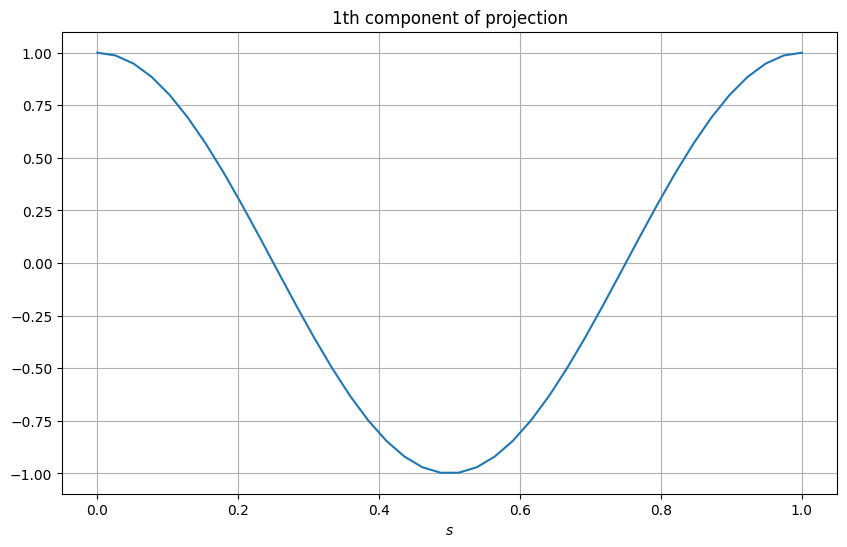

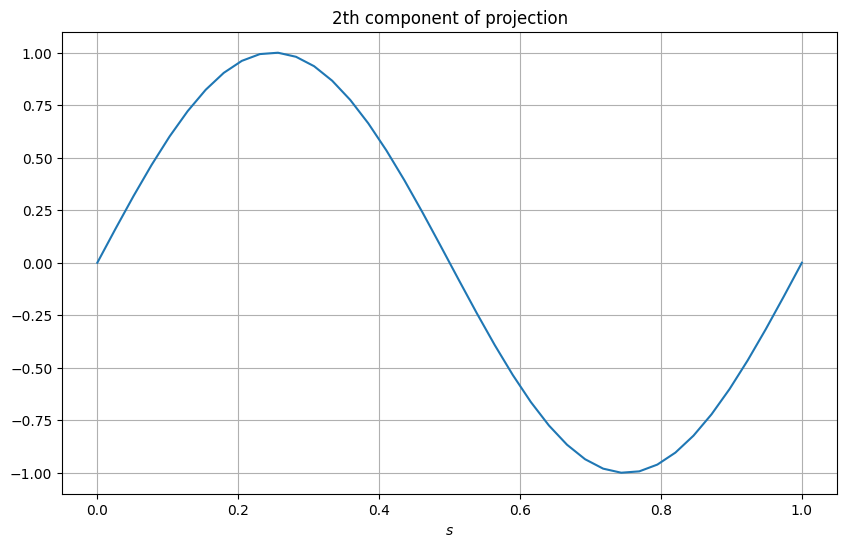

In [25]:
# plot dataset
for i in range(d):
    plt.plot(s_test, Ws_test[:,i,0])
    plt.title(f'{i+1}th component of projection')
    plt.grid()
    plt.xlabel(r'$s$')
    plt.show()

anchor_point = [[0.8494679204089295], [-0.5276402677924881]]


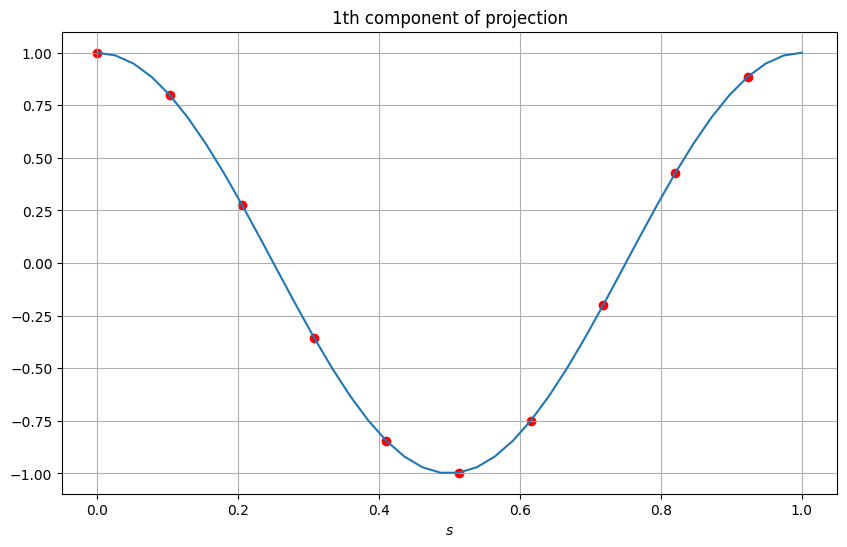

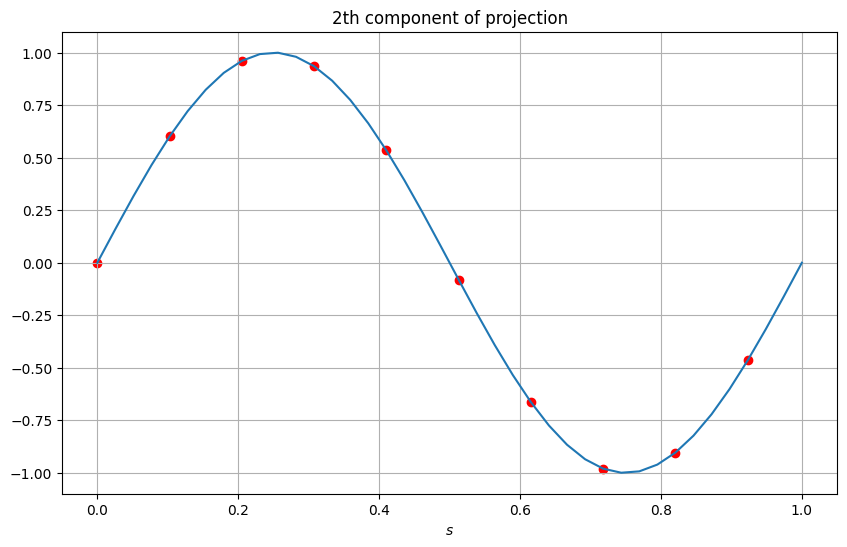

In [26]:
# subsample data
s_gap = 4
s_train = s_test[::s_gap].copy()
Ws_train = Ws_test[::s_gap,:,:].copy()

# compute barycenter of train data
anchor_point = compute_barycenter(Ws_train)
assert valid_grass_point(anchor_point)
print(f"anchor_point = {anchor_point.tolist()}")

# compute log of training data and full data
log_Ws_train = vmap(lambda W: grass_log(anchor_point, W))(Ws_train)
log_Ws_test = vmap(lambda W: grass_log(anchor_point, W))(Ws_test)

for i in range(d):
    plt.plot(s_test, Ws_test[:,i,0])
    plt.scatter(s_train, Ws_train[:,i,0], c='r')
    plt.title(f'{i+1}th component of projection')
    plt.grid()
    plt.xlabel(r'$s$')
    plt.show()

In [29]:
# save training and testing data
training_test_data = {'s_train': s_train, 'Ws_train': Ws_train, 's_test': s_test, 'Ws_test': Ws_test, 'log_Ws_train': log_Ws_train, 'log_Ws_test': log_Ws_test}
head = './datasets'
main_name_training_test = "training_test_data_gpsr_example"
path_training_test = get_save_path(head, main_name_training_test)
print(path_training_test)
try:
    safe_save(path_training_test, training_test_data)
except FileExistsError:
    print("File exists so not saving.")

./datasets/training_test_data_gpsr_example


In [31]:
from grassgp.utils import load_and_convert_to_samples_dict as load_data

In [33]:
load_data(path_training_test + '.npz').keys()

dict_keys(['s_train', 'Ws_train', 's_test', 'Ws_test', 'log_Ws_train', 'log_Ws_test'])

In [6]:
def run_svi_for_map(rng_key, model, maxiter, step_size, *args):
    start = time.time()
    guide = autoguide.AutoDelta(model)
    optimzer = numpyro.optim.Adam(step_size)
    svi = SVI(model, guide, optimzer, Trace_ELBO())
    svi_results = svi.run(rng_key, maxiter, *args)
    print('\nSVI elapsed time:', time.time() - start)
    return svi_results

In [7]:
model_config = {
    'anchor_point': anchor_point.tolist(),
    'd_in': 1,
    'Omega' : None,
    'k_include_noise': True,
    'var' : None,
    'length' : 1.0, 
    'noise' : None,
    'require_noise' : False,
    'jitter' : 1e-06,
    'cov_jitter' : 1e-4,
    'L_jitter' : 1e-8,
    'reorthonormalize' : False,
    'b' : 1.0,
    'ell': 0.0075
}

def model(s, log_Ws, grass_config = model_config):
    U = np.array(grass_config['anchor_point'])
    d, n = U.shape
    N = s.shape[0]
    d_n = d * n
    N_params = N * d_n
    if log_Ws is not None:
        assert log_Ws.shape == (N, d, n)
    
    # get/sample Omega
    if grass_config['Omega'] is None:
        sigmas = numpyro.sample('sigmas', dist.LogNormal(0.0, 1.0).expand([d_n]))
        L_factor = numpyro.sample('L_factor', dist.LKJ(d_n, 1.0))
        L = numpyro.deterministic('L', L_factor + grass_config['L_jitter'] * np.eye(d_n))
        Omega = numpyro.deterministic('Omega', np.outer(sigmas, sigmas) * L)
    else:
        Omega = np.array(grass_config['Omega'])
        
    # get/sample kernel params
    if grass_config['var'] is None:
        # sample var
        var = numpyro.sample("kernel_var", dist.LogNormal(0.0, grass_config['b']))
    else:
        var = grass_config['var']

    if grass_config['length'] is None:
        # sample length
        length = numpyro.sample("kernel_length", dist.LogNormal(0.0, grass_config['b']))
    else:
        length = grass_config['length']

    if grass_config['require_noise']:
        if grass_config['noise'] is None:
            # sample noise
            noise = numpyro.sample("kernel_noise", dist.LogNormal(0.0, grass_config['b']))
        else:
            noise = grass_config['noise']
    else:
        noise = 0.0
    
    kernel_params = {'var': var, 'length': length, 'noise': noise}
    # create kernel function
    k = lambda t, s: rbf(t, s, kernel_params, jitter=grass_config['jitter'], include_noise=grass_config['k_include_noise'])
    # create mean function
    mu = lambda s: zero_mean(s, d, n)

    # initialize GrassGP
    grass_gp = GrassGP(d_in=grass_config['d_in'], d_out=(d,n), mu=mu, k=k, Omega=Omega, U=U, cov_jitter=grass_config['cov_jitter'])
    
    # sample Deltas
    Deltas = grass_gp.tangent_model(s)
    
    # # ! check what power this should be
    # likelihood
    ell = grass_config['ell']
    with numpyro.plate("N", N):
        numpyro.sample("log_W", dist.continuous.MatrixNormal(loc=Deltas, scale_tril_row=ell * np.eye(d),scale_tril_column=np.eye(n)), obs=log_Ws)

TangentSpaceModelConf = builds(model, grass_config=model_config, zen_partial=True)

In [8]:
SVIConfig = make_config(
    seed = 123514354575,
    maxiter = 10000,
    step_size = 0.001
)

TrainConfig = make_config(
    seed = 9870687,
    n_warmup = 1000,
    n_samples = 1000,
    n_chains = 1,
    n_thinning = 2,
    init_strategy = init_to_median(num_samples=10)
)

Config = make_config(
    model = TangentSpaceModelConf,
    svi = SVIConfig,
    train = TrainConfig
)

In [9]:
# numpyro.render_model(model, model_args=(s_train,log_Ws_train))

In [40]:
def train(cfg):
    # save training and testing data
    training_test_data = {'s_train': s_train, 'Ws_train': Ws_train, 's_test': s_test, 'Ws_test': Ws_test, 'log_Ws_train': log_Ws_train, 'log_Ws_test': log_Ws_test}
    head = os.getcwd()
    main_name_training_test = "training_test_data"
    path_training_test = get_save_path(head, main_name_training_test)
    try:
        safe_save(path_training_test, training_test_data)
    except FileExistsError:
        print("File exists so not saving.")
    
    # instantiate grass model
    model = instantiate(cfg.model)
    
    # run SVI to get MAP esimtate to initialise MCMC
    svi_key = random.PRNGKey(cfg.svi.seed)
    maxiter = cfg.svi.maxiter
    step_size = cfg.svi.step_size
    print("Running SVI for MAP estimate to initialise MCMC")
    svi_results = run_svi_for_map(svi_key, model, maxiter, step_size, s_train, log_Ws_train)
    
    # run HMC
    train_key = random.PRNGKey(cfg.train.seed)
    mcmc_config = {'num_warmup' : cfg.train.n_warmup, 'num_samples' : cfg.train.n_samples, 'num_chains' : cfg.train.n_chains, 'thinning' : cfg.train.n_thinning, 'init_strategy' : instantiate(cfg.train.init_strategy)}
    print("HMC starting.")
    mcmc = run_inference(train_key, mcmc_config, model, s_train, log_Ws_train)
    # original_stdout = sys.stdout
    # with open('hmc_log.txt', 'w') as f:
    #     sys.stdout = f
    #     mcmc.print_summary()
    #     sys.stdout = original_stdout
    
    samples = mcmc.get_samples()
    
    # head = os.getcwd()
    # main_name = "samples_data"
    # path = get_save_path(head, main_name)
    # try:
    #     safe_save(path, samples)
    # except FileExistsError:
    #     print("File exists so not saving.")
    
    return samples

In [41]:
cfg = Config
samples = train(cfg)

HMC starting.


sample: 100%|█| 2000/2000 [00:48<00:00, 40.87it/s, 1023 steps of size 7.92e-04. 



                   mean       std    median      5.0%     95.0%     n_eff     r_hat
L_factor[0,0]      1.00      0.00      1.00      1.00      1.00       nan       nan
L_factor[0,1]     -0.09      0.02     -0.09     -0.13     -0.05      7.67      1.57
L_factor[1,0]     -0.09      0.02     -0.09     -0.13     -0.05      7.67      1.57
L_factor[1,1]      1.00      0.00      1.00      1.00      1.00    170.11      1.00
         Z[0]     -0.20      0.06     -0.22     -0.28     -0.09      7.83      1.15
         Z[1]     -0.02      0.01     -0.02     -0.03     -0.01     14.79      1.01
         Z[2]     -0.30      0.06     -0.28     -0.41     -0.22      4.31      1.70
         Z[3]     -0.01      0.01     -0.01     -0.03      0.00      4.35      2.00
         Z[4]     -0.38      0.08     -0.36     -0.52     -0.28      4.98      1.30
         Z[5]     -0.02      0.01     -0.02     -0.04     -0.01      7.36      1.00
         Z[6]      0.04      0.10      0.01     -0.11      0.18      3.45  

In [42]:
samples.keys()

dict_keys(['Deltas', 'L', 'L_factor', 'Omega', 'Vs', 'Z', 'kernel_var', 'sigmas', 'vec_Vs'])

In [43]:
from grassgp.plot_utils import flatten_samples

In [44]:
my_samples = flatten_samples(samples, ignore=[])

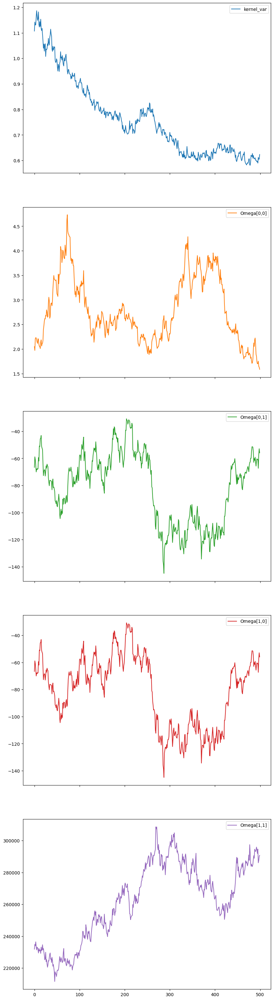

In [45]:
trace_plot_vars = [ 'kernel_var']
for key in my_samples.keys():
    if 'Omega' in key:
        trace_plot_vars.append(key)

my_samples[trace_plot_vars].plot(subplots=True, figsize=(10,40), sharey=False)
plt.show()

In [46]:
samples_Ws_train = vmap(lambda Deltas: convert_to_projs(Deltas, anchor_point, reorthonormalize=False))(samples['Deltas'])

for ws in samples_Ws_train:
    assert vmap(valid_grass_point)(ws).all()

In [47]:
from grassgp.plot_utils import plot_grass_dists

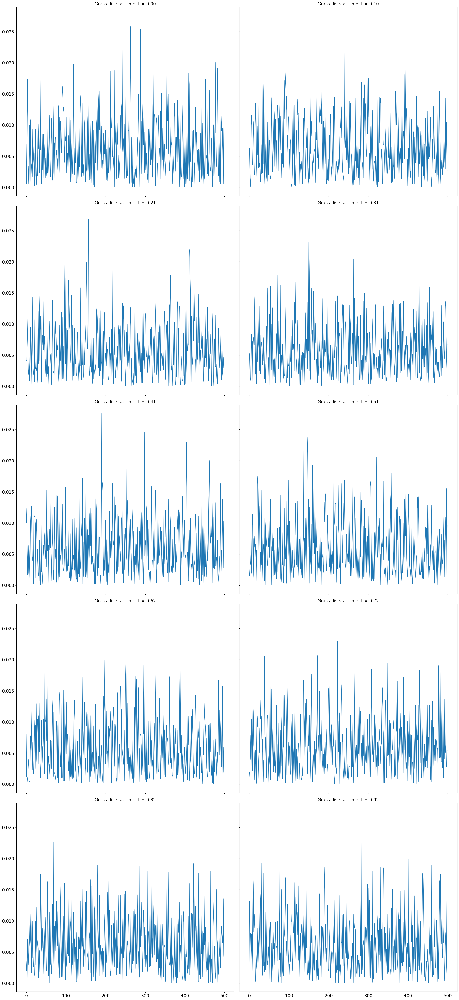

In [48]:
plot_grass_dists(samples_Ws_train, Ws_train, s_train)

In [49]:
alphas = np.array([subspace_angle(w) for w in Ws_test])
alphas_train = np.array([subspace_angle(w) for w in Ws_train])
samples_alphas_train = np.array([[subspace_angle(w)for w in Ws_sample] for Ws_sample in samples_Ws_train])

In [50]:
percentile_levels = [2.5, 97.5]
conf_level = percentile_levels[-1] - percentile_levels[0]
percentiles = np.percentile(samples_alphas_train, np.array(percentile_levels), axis=0)
lower = percentiles[0,:]
upper = percentiles[1,:]

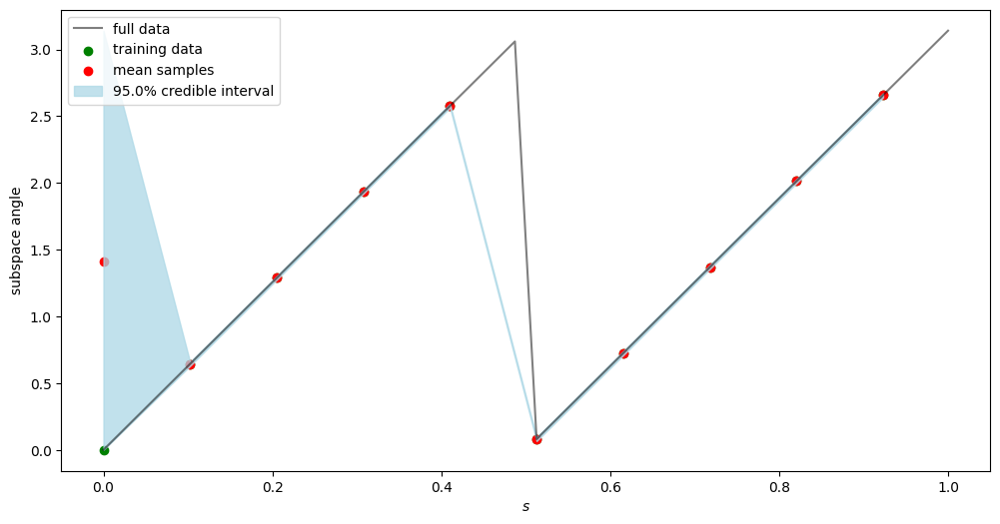

In [51]:
plt.plot(s_test, alphas, c='black', alpha=0.5, label='full data')
plt.scatter(s_train, alphas_train, label='training data', c='g')
plt.scatter(s_train, samples_alphas_train.mean(axis=0), label='mean samples', c='r')
plt.fill_between(s_train, lower, upper,  color='lightblue', alpha=0.75,label=f'{conf_level}% credible interval')
plt.xlabel(r"$s$")
plt.ylabel("subspace angle")
plt.legend()
plt.show()

In [52]:
samples.keys()

dict_keys(['Deltas', 'L', 'L_factor', 'Omega', 'Vs', 'Z', 'kernel_var', 'sigmas', 'vec_Vs'])

In [53]:
dict_cfg = to_dictconf(cfg)

In [54]:
def predict_tangents(
    key: chex.ArrayDevice,
    s_test: chex.ArrayDevice,
    s_train: chex.ArrayDevice,
    Vs_train: chex.ArrayDevice,
    dict_cfg,
    samples: dict,
    jitter: float = 1e-8
) -> Tuple[chex.ArrayDevice, chex.ArrayDevice]:
    
    d_in = dict_cfg.model.grass_config.d_in
    U = np.array(dict_cfg.model.grass_config.anchor_point)
    d, n = U.shape
    cov_jitter = dict_cfg.model.grass_config.cov_jitter
    k_include_noise = dict_cfg.model.grass_config.k_include_noise
    kern_jitter = dict_cfg.model.grass_config.jitter
    n_samples = dict_cfg.train.n_samples // dict_cfg.train.n_thinning
    assert n_samples == samples['Deltas'].shape[0]
    
    def predict(
        key: chex.ArrayDevice,
        Omega: chex.ArrayDevice,
        var: float,
        length: float,
        noise: float,
    ) -> Tuple[chex.ArrayDevice, chex.ArrayDevice]:
        # iniatilize GrassGP
        kernel_params = {'var': var, 'length': length, 'noise': noise}
        k = lambda t, s: rbf(t, s, kernel_params, jitter=kern_jitter, include_noise=k_include_noise)
        mu = lambda s: zero_mean(s, d, n)
        grass_gp = GrassGP(d_in=d_in, d_out=(d, n), mu=mu, k=k, Omega=Omega, U=U, cov_jitter=cov_jitter)

        # predict
        Deltas_mean, Deltas_pred = grass_gp.predict_tangents(key, s_test, s_train, Vs_train, jitter=jitter)
        return Deltas_mean, Deltas_pred

    # initialize vmap args
    vmap_args = (random.split(key, n_samples),)
    
    cfg_Omega = dict_cfg.model.grass_config.Omega
    cfg_var = dict_cfg.model.grass_config.var
    cfg_length = dict_cfg.model.grass_config.length
    cfg_noise = dict_cfg.model.grass_config.noise
    cfg_require_noise = dict_cfg.model.grass_config.require_noise
    
    if cfg_Omega is None:
        vmap_args += (samples['Omega'],)
    else:
        cfg_Omega = np.array(cfg_Omega)
        vmap_args += (np.repeat(cfg_Omega[None,:,:], n_samples, axis=0),)
    
    if cfg_var is None:
        vmap_args += (samples['kernel_var'],)
    else:
        vmap_args += (cfg_var * np.ones(n_samples),)
        
    if cfg_length is None:
        vmap_args += (samples['kernel_length'],)
    else:
        vmap_args += (cfg_length * np.ones(n_samples),)
        
    if cfg_require_noise:
        if cfg_noise is None:
            vmap_args += (samples['kernel_noise'],)
        else:
            vmap_args += (cfg_noise * np.ones(n_samples),)
    else:
        vmap_args += (np.zeros(n_samples),)
    
    assert len(vmap_args) == 5
    Deltas_means, Deltas_preds = vmap(predict)(*vmap_args)
    return Deltas_means, Deltas_preds

In [55]:
pred_key = random.PRNGKey(6578)
Deltas_means, Deltas_preds = predict_tangents(pred_key, s_test, s_train, log_Ws_train, dict_cfg, samples)
assert np.isnan(Deltas_means).sum() == 0
assert np.isnan(Deltas_preds).sum() == 0

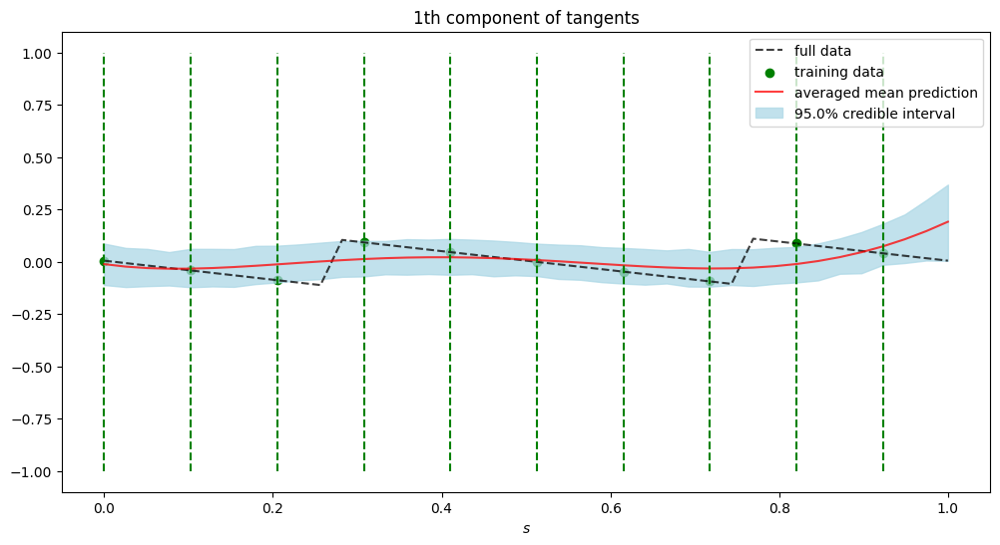

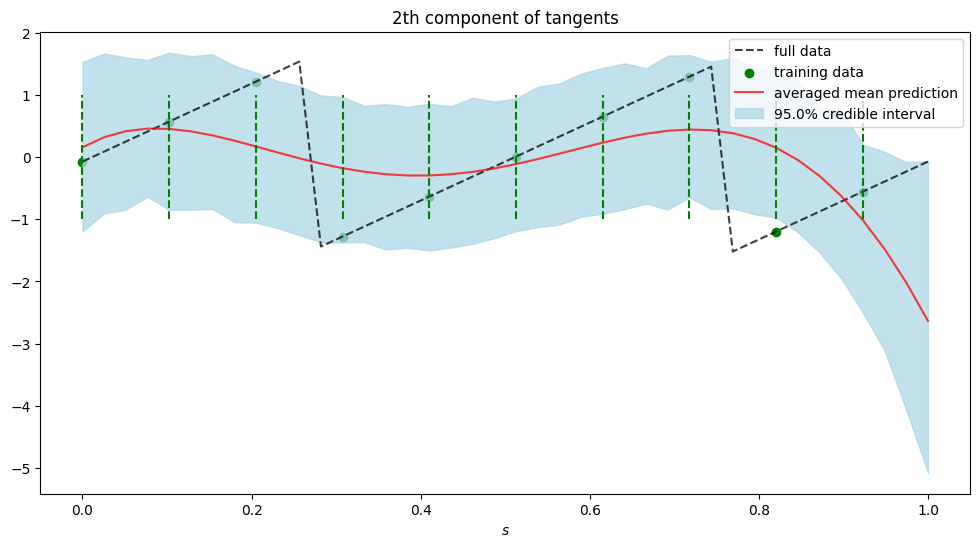

In [56]:
plt.rcParams["figure.figsize"] = (12,6)
percentile_levels = [2.5, 97.5]
conf_level = percentile_levels[-1] - percentile_levels[0]
for i in range(d):
    obs = log_Ws_train[:,i,0]
    means = Deltas_means[:,:,i,0]
    means_avg = np.mean(means, axis=0)
    preds = Deltas_preds[:,:,i,0]
    percentiles = np.percentile(preds, np.array(percentile_levels), axis=0)
    lower = percentiles[0,:]
    upper = percentiles[1,:]
    plt.plot(s_test, log_Ws[:,i,0], label='full data',c='black', alpha=0.75, linestyle='dashed')
    plt.scatter(s_train, log_Ws_train[:,i,0], label='training data', c='g')
    plt.plot(s_test, means_avg, label='averaged mean prediction', c='r', alpha=0.75)
    plt.fill_between(s_test, lower, upper, color='lightblue', alpha=0.75, label=f'{conf_level}% credible interval')
    plt.xlabel(r"$s$")
    plt.legend()
    plt.vlines(s_train, -1, 1, colors='green', linestyles='dashed')
    plt.title(f"{i+1}th component of tangents")
    plt.show()

In [57]:
def predict_grass(
    key: chex.ArrayDevice,
    s_test: chex.ArrayDevice,
    s_train: chex.ArrayDevice,
    Vs_train: chex.ArrayDevice,
    dict_cfg,
    samples: dict,
    jitter: float = 1e-8,
    reortho: bool = False
) -> Tuple[chex.ArrayDevice, chex.ArrayDevice]:
    
    d_in = dict_cfg.model.grass_config.d_in
    U = np.array(dict_cfg.model.grass_config.anchor_point)
    d, n = U.shape
    cov_jitter = dict_cfg.model.grass_config.cov_jitter
    k_include_noise = dict_cfg.model.grass_config.k_include_noise
    kern_jitter = dict_cfg.model.grass_config.jitter
    n_samples = dict_cfg.train.n_samples // dict_cfg.train.n_thinning
    assert n_samples == samples['Deltas'].shape[0]
    
    def predict(
        key: chex.ArrayDevice,
        Omega: chex.ArrayDevice,
        var: float,
        length: float,
        noise: float,
    ) -> Tuple[chex.ArrayDevice, chex.ArrayDevice]:
        # iniatilize GrassGP
        kernel_params = {'var': var, 'length': length, 'noise': noise}
        k = lambda t, s: rbf(t, s, kernel_params, jitter=kern_jitter, include_noise=k_include_noise)
        mu = lambda s: zero_mean(s, d, n)
        grass_gp = GrassGP(d_in=d_in, d_out=(d, n), mu=mu, k=k, Omega=Omega, U=U, cov_jitter=cov_jitter)

        # predict
        Ws_mean, Ws_pred = grass_gp.predict_grass(key, s_test, s_train, Vs_train, jitter=jitter, reortho=reortho)
        return Ws_mean, Ws_pred

    # initialize vmap args
    vmap_args = (random.split(key, n_samples),)
    
    cfg_Omega = dict_cfg.model.grass_config.Omega
    cfg_var = dict_cfg.model.grass_config.var
    cfg_length = dict_cfg.model.grass_config.length
    cfg_noise = dict_cfg.model.grass_config.noise
    cfg_require_noise = dict_cfg.model.grass_config.require_noise
    
    if cfg_Omega is None:
        vmap_args += (samples['Omega'],)
    else:
        cfg_Omega = np.array(cfg_Omega)
        vmap_args += (np.repeat(cfg_Omega[None,:,:], n_samples, axis=0),)
    
    if cfg_var is None:
        vmap_args += (samples['kernel_var'],)
    else:
        vmap_args += (cfg_var * np.ones(n_samples),)
        
    if cfg_length is None:
        vmap_args += (samples['kernel_length'],)
    else:
        vmap_args += (cfg_length * np.ones(n_samples),)
        
    if cfg_require_noise:
        if cfg_noise is None:
            vmap_args += (samples['kernel_noise'],)
        else:
            vmap_args += (cfg_noise * np.ones(n_samples),)
    else:
        vmap_args += (np.zeros(n_samples),)
    
    assert len(vmap_args) == 5
    Ws_means, Ws_preds = vmap(predict)(*vmap_args)
    return Ws_means, Ws_preds

In [58]:
pred_key_grass = random.PRNGKey(7695)
Ws_means, Ws_preds = predict_grass(pred_key, s_test, s_train, log_Ws_train, dict_cfg, samples)
assert np.isnan(Ws_means).sum() == 0
assert np.isnan(Ws_preds).sum() == 0

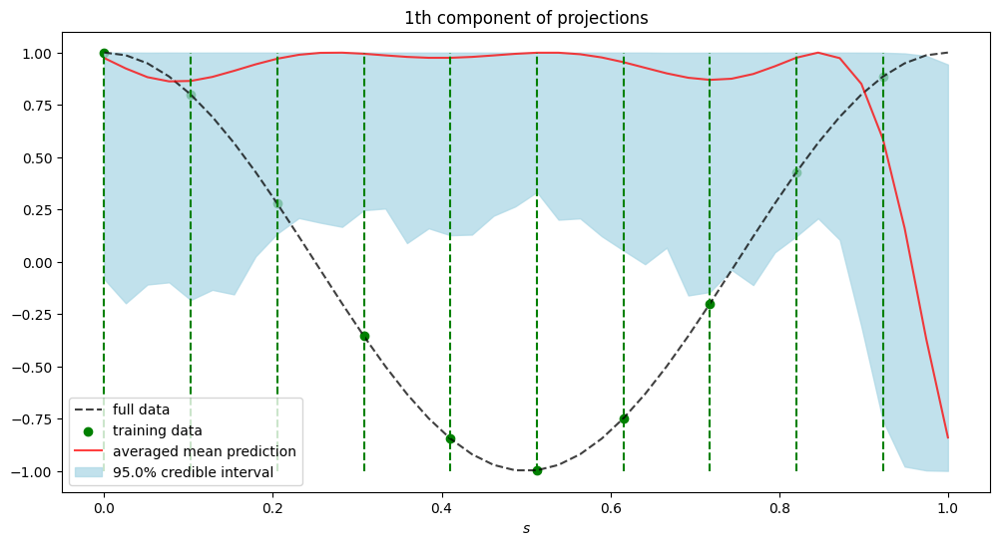

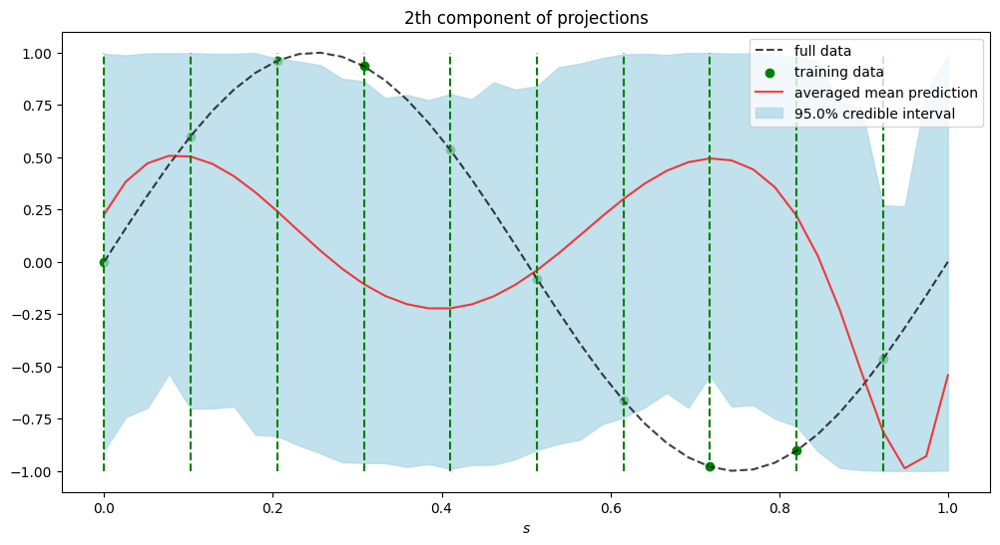

In [59]:
plt.rcParams["figure.figsize"] = (12,6)
percentile_levels = [2.5, 97.5]
conf_level = percentile_levels[-1] - percentile_levels[0]
for i in range(d):
    obs = Ws_train[:,i,0]
    means = Ws_means[:,:,i,0]
    means_avg = np.mean(means, axis=0)
    preds = Ws_preds[:,:,i,0]
    percentiles = np.percentile(preds, np.array(percentile_levels), axis=0)
    lower = percentiles[0,:]
    upper = percentiles[1,:]
    plt.plot(s_test, Ws_test[:,i,0], label='full data',c='black', alpha=0.75, linestyle='dashed')
    plt.scatter(s_train, Ws_train[:,i,0], label='training data', c='g')
    plt.plot(s_test, means_avg, label='averaged mean prediction', c='r', alpha=0.75)
    plt.fill_between(s_test, lower, upper, color='lightblue', alpha=0.75, label=f'{conf_level}% credible interval')
    plt.xlabel(r"$s$")
    plt.legend()
    plt.vlines(s_train, -1, 1, colors='green', linestyles='dashed')
    plt.title(f"{i+1}th component of projections")
    plt.show()

In [60]:
alphas_means = np.array([[subspace_angle(w) for w in mean] for mean in Ws_means])
alphas_preds = np.array([[subspace_angle(w) for w in pred] for pred in Ws_preds])

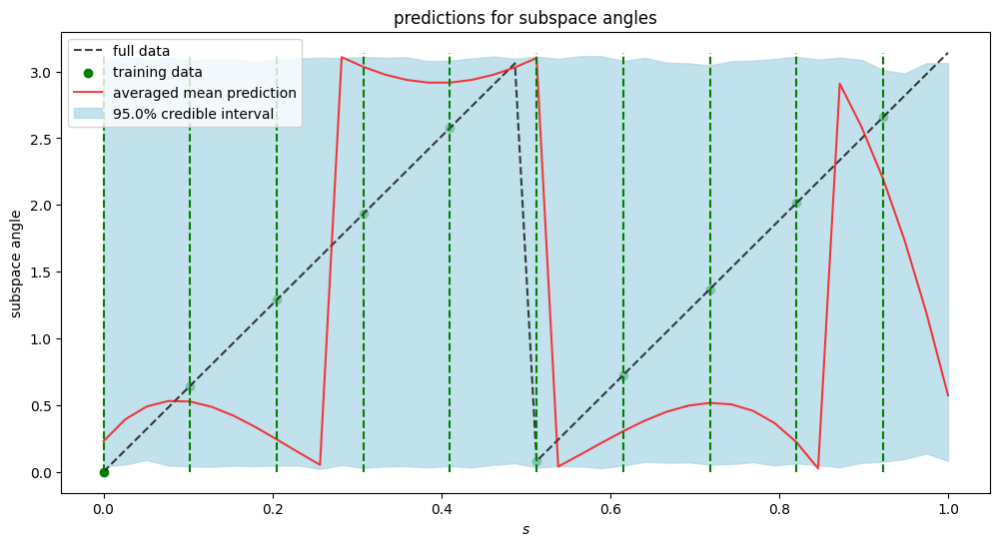

In [61]:
plt.rcParams["figure.figsize"] = (12,6)
percentile_levels = [2.5, 97.5]
conf_level = percentile_levels[-1] - percentile_levels[0]
alphas_means_avg = np.mean(alphas_means, axis=0)
percentiles = np.percentile(alphas_preds, np.array(percentile_levels), axis=0)
lower = percentiles[0,:]
upper = percentiles[1,:]
plt.plot(s_test, alphas, label='full data',c='black', alpha=0.75, linestyle='dashed')
plt.scatter(s_train, alphas_train, label='training data', c='g')
plt.plot(s_test, alphas_means_avg, label='averaged mean prediction', c='r', alpha=0.75)
plt.fill_between(s_test, lower, upper, color='lightblue', alpha=0.75, label=f'{conf_level}% credible interval')
plt.xlabel(r"$s$")
plt.ylabel("subspace angle")
plt.legend()
plt.vlines(s_train, 0, np.pi, colors='green', linestyles='dashed')
plt.title(f"predictions for subspace angles")
plt.show()

In [62]:
from grassgp.plot_utils import plot_AS_dir_preds

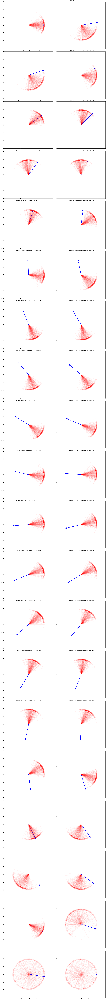

In [34]:
plot_AS_dir_preds(Ws_preds, Ws_test, s_test, s_train)

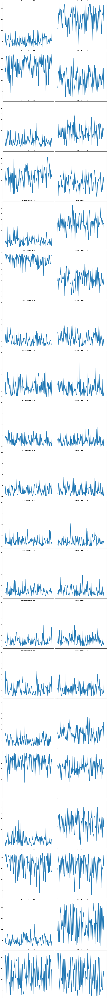

In [35]:
plot_grass_dists(Ws_preds, Ws_test, s_test)